In [1]:
import os
import torch
from torch.utils.data import Dataset
from PIL import Image
from torchvision import transforms
import numpy as np
from cityscapesscripts.helpers.labels import id2label

class CityscapesDataset(Dataset):
    def __init__(self, image_folder, label_folder,augmentation=None):
        self.image_folder = image_folder
        self.label_folder = label_folder
        self.augmentation = augmentation
        
        self.image_paths = sorted([os.path.join(image_folder, x) for x in os.listdir(image_folder) if x.endswith('.png')])
        self.label_paths = sorted([os.path.join(label_folder, x) for x in os.listdir(label_folder) if x.endswith('gtFine_labelIds.png')])

        # Optional check
        assert len(self.image_paths) == len(self.label_paths), "Mismatch between images and labels"

    def __len__(self):
        return len(self.image_paths) 

    def __getitem__(self, idx):
        image_path = self.image_paths[idx]
        label_path = self.label_paths[idx]

        image=Image.open(image_path).convert('RGB')
        label=Image.open(label_path)
        label=np.array(label)
        label=self.remap_to_train_id(label)


        if self.augmentation:
            augmented = self.augmentation(image=np.array(image), mask=label)
            image = augmented['image']
            label = augmented['mask']
        
        return image, label

    ## this is a funtion to remap the label id to train id because in cutyscaors dataset there are 34 classses, someof which are not useful 
    ## so by converting them into 19 using Github original repo code of cityscapes dataset
    # cityscapesscripts library
    
    def remap_to_train_id(self, label_np):
        label_train = np.full_like(label_np, 255) 
        
        for id, label in id2label.items():
            if label.trainId != -1:  
                label_train[label_np == id] = label.trainId
        
        label_train[label_train == -1] = 255  

        return label_train

In [2]:
# import albumentations as A
# from albumentations.pytorch import ToTensorV2



# train_augmentation = A.Compose([
#     A.HorizontalFlip(p=0.5),
#     A.ColorJitter(brightness=0.4, contrast=0.4, saturation=0.3, hue=0.1, p=0.8),
#     A.Rotate(limit=10, p=0.7),  # ±10 degrees
#     A.Normalize(mean=(0.485, 0.456, 0.406),
#                 std=(0.229, 0.224, 0.225),
#                 max_pixel_value=255.0),
#     ToTensorV2()
# ])

# val_augmentation= A.Compose([

#     A.Resize(height=512, width=512),
#     A.Normalize(mean=(0.485, 0.456, 0.406),
#                 std=(0.229, 0.224, 0.225),
#                 max_pixel_value=255.0),
#     ToTensorV2()
# ])


import albumentations as A
from albumentations.pytorch import ToTensorV2

# train_augmentation = A.Compose([
#     A.RandomCrop(width=512, height=512),
#     A.HorizontalFlip(p=0.5),
#     A.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1, p=0.5),
#     A.GaussianBlur(blur_limit=(3, 7), p=0.5),
#     A.Normalize(mean=(0.485, 0.456, 0.406),
#                 std=(0.229, 0.224, 0.225),
#                 max_pixel_value=255.0),
#     ToTensorV2()

# ])
train_augmentation = A.Compose([
    A.RandomCrop(width=512, height=512),
    
    # Random rotation within ±10 degrees
    A.Rotate(limit=10, p=0.5),
    
    # Horizontal flip with 50% probability
    A.HorizontalFlip(p=0.5),
    
    # First color adjustment pass
    A.ColorJitter(
        brightness=0.4,  # ±40%
        contrast=0.4,    # ±40%
        saturation=0.3,  # ±30%
        hue=0.1,         # ±10%
        p=0.5
    ),
    
    # Second color adjustment pass (as per paper)
    A.ColorJitter(
        brightness=0.4,
        contrast=0.4,
        saturation=0.3,
        hue=0.1,
        p=0.5
    ),
    
    # Optional Gaussian Blur to simulate camera effects
    A.GaussianBlur(blur_limit=(3, 7), p=0.5),

    # Normalization and conversion to tensor
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225),
                max_pixel_value=255.0),
    ToTensorV2()
])


val_augmentation= A.Compose([

    A.Resize(height=512, width=512),
    A.Normalize(mean=(0.485, 0.456, 0.406),
                std=(0.229, 0.224, 0.225),
                max_pixel_value=255.0),
    ToTensorV2()
])

In [3]:
train_input_dir="/data/Cityscapes/Input/leftImg8bit/train_final"
train_label_dir="/data/Cityscapes/Output/train_final"
val_input_dir="/data/Cityscapes/Input/leftImg8bit/val_final"
val_label_dir="/data/Cityscapes/Output/val_final"
test_input_dir="/data/Cityscapes/Input/leftImg8bit/test_final"
test_label_dir="/data/Cityscapes/Output/test_final"

In [4]:
train_dataset = CityscapesDataset(
    image_folder=train_input_dir,
    label_folder=train_label_dir,
    augmentation=train_augmentation
)
val_dataset = CityscapesDataset(
    image_folder=val_input_dir,
    label_folder=val_label_dir,
    augmentation=val_augmentation
)
test_dataset = CityscapesDataset(
    image_folder=test_input_dir,
    label_folder=test_label_dir,
    augmentation=val_augmentation
)

In [5]:
from torch.utils.data import DataLoader

train_loader = DataLoader(
    train_dataset,
    batch_size=16,
    shuffle=True,
    num_workers=4,
    pin_memory=True
)
val_loader = DataLoader(
    val_dataset,
    batch_size=16,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)
test_loader = DataLoader(   
    test_dataset,
    batch_size=16,
    shuffle=False,
    num_workers=4,
    pin_memory=True
)

In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models

class ASPPModule(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ASPPModule, self).__init__()
        
        self.atrousBlock1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.atrousBlock2 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=6, dilation=6),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        self.atrousBlock3 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=12, dilation=12),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()        
        )

        self.atrousBlock4 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=18, dilation=18),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        
        self.imagePooling = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

        # SKFusion after concatenation of ASPP features
        self.skfusion = SKFusion(in_channels=out_channels * 5)

        self.output = nn.Sequential(
            nn.Conv2d(out_channels * 5, out_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )

    def forward(self, x):        
        x1 = self.atrousBlock1(x)
        x2 = self.atrousBlock2(x)
        x3 = self.atrousBlock3(x)
        x4 = self.atrousBlock4(x)

        img_pool = F.interpolate(self.imagePooling(x), size=x.shape[2:], mode='bilinear', align_corners=False)

        x = torch.cat([x1, x2, x3, x4, img_pool], dim=1)
        x = self.skfusion(x)  # Apply SKFusion to ASPP features
        return self.output(x)

class SKFusion(nn.Module):
    def __init__(self, in_channels, reduction=16):
        super(SKFusion, self).__init__()
        self.in_channels = in_channels

        # Split: Two convolution paths with different kernel sizes (3x3 and 5x5)
        self.conv_3x3 = nn.Conv2d(in_channels, in_channels, kernel_size=3, padding=1)
        self.conv_5x5 = nn.Conv2d(in_channels, in_channels, kernel_size=5, padding=2)

        # Fuse: Global average pooling and fully connected layers
        self.global_pool = nn.AdaptiveAvgPool2d(1)
        self.fc1 = nn.Linear(in_channels, in_channels // reduction)
        self.fc2 = nn.Linear(in_channels // reduction, in_channels * 2)  # For two branches (3x3 and 5x5)

    def forward(self, x):
        # Split
        u1 = self.conv_3x3(x)  # 3x3 convolution
        u2 = self.conv_5x5(x)  # 5x5 convolution

        # Fuse: Element-wise summation
        u = u1 + u2

        # Global average pooling
        s = self.global_pool(u).view(-1, self.in_channels)

        # Fully connected layers to compute attention weights
        z = F.relu(self.fc1(s))
        a_b = self.fc2(z)  # Shape: (batch_size, in_channels * 2)

        # Reshape and softmax to get weights for each branch
        a_b = a_b.view(-1, 2, self.in_channels)  # (batch_size, 2, in_channels)
        a_b = F.softmax(a_b, dim=1)  # Softmax over the branch dimension

        # Select: Compute weighted sum of features
        a, b = a_b[:, 0, :], a_b[:, 1, :]  # Weights for 3x3 and 5x5
        a = a.view(-1, self.in_channels, 1, 1)  # Reshape for broadcasting
        b = b.view(-1, self.in_channels, 1, 1)

        v = a * u1 + b * u2  # Weighted combination of features
        return v

class Decoder(nn.Module):
    def __init__(self, low_channels, out_channels, num_classes):
        super().__init__()

        self.reduce_low = nn.Sequential(
            nn.Conv2d(low_channels, 48, 1),
            nn.BatchNorm2d(48),
            nn.ReLU()
        )

        # SKFusion after concatenation of low and high features
        self.skfusion = SKFusion(in_channels=48 + out_channels)

        self.fuse = nn.Sequential(
            nn.Conv2d(48 + out_channels, 256, 3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Conv2d(256, 256, 3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(),
        )

        self.classifier = nn.Conv2d(256, num_classes, 1)

    def forward(self, low_feat, high_feat):
        low_feat = self.reduce_low(low_feat)
        high_feat = F.interpolate(high_feat, size=low_feat.shape[2:], mode='bilinear', align_corners=False)

        x = torch.cat([low_feat, high_feat], dim=1)
        x = self.skfusion(x)  # Apply SKFusion attention
        x = self.fuse(x)
        return self.classifier(x)

class MobileNetV2Backbone(nn.Module):
    def __init__(self, low_level_idx=2, high_level_idx=4):
        super().__init__()
        base_model = models.mobilenet_v2(pretrained=True)
        self.low_level_features = base_model.features[:4]
        self.high_level_features = base_model.features[4:]

    def forward(self, x):
        low_feat = self.low_level_features(x)
        high_feat = self.high_level_features(low_feat)
        return low_feat, high_feat

class DeepLabV3Plus(nn.Module):
    def __init__(self, num_classes):
        super().__init__()
        self.backbone = MobileNetV2Backbone()
        self.aspp = ASPPModule(in_channels=1280, out_channels=256)
        self.decoder = Decoder(low_channels=24, out_channels=256, num_classes=num_classes)

    def forward(self, x):
        input_size = x.shape[2:]
        low, high = self.backbone(x)
        high = self.aspp(high)
        x = self.decoder(low, high)
        x = F.interpolate(x, size=input_size, mode='bilinear', align_corners=False)
        return x

In [8]:
import torch
from tqdm import tqdm
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

def train_model(model, train_loader, val_loader, num_epochs, criterion, optimizer, device, scheduler=None, save_path="attention-model.pth"):
    model.to(device)
    best_val_acc = 0.0  # Track the best validation accuracy

    # Store metrics for plotting
    train_losses = []
    train_accuracies = []
    val_losses = []
    val_accuracies = []

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        total_correct = 0
        total_pixels = 0

        print(f"Epoch [{epoch+1}/{num_epochs}]")

        for images, labels in tqdm(train_loader, desc="Training"):
            images, labels = images.to(device), labels.to(device).long()

            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            train_loss += loss.item()
            preds = outputs.argmax(dim=1)
            total_correct += (preds == labels).sum().item()
            total_pixels += torch.numel(labels)

        avg_train_loss = train_loss / len(train_loader)
        train_pixel_acc = total_correct / total_pixels
        train_losses.append(avg_train_loss)
        train_accuracies.append(train_pixel_acc)

        print(f"Train Loss: {avg_train_loss:.4f} | Pixel Acc: {train_pixel_acc:.4f}")

        # val_loss, val_acc = evaluate(model, val_loader, criterion, device)
        val_loss, val_acc, val_miou = evaluate(model, val_loader, criterion, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)

        print(f"Val Loss: {val_loss:.4f} | Val Pixel Acc: {val_acc:.4f} | mIoU: {val_miou:.4f}")

        if val_acc > best_val_acc:
            best_val_acc = val_acc
            print(f"Validation accuracy improved! Saving model...")
            torch.save(model.state_dict(), save_path)

        if scheduler:
            scheduler.step()

    print("Training complete!")

    # Plot training and validation curves
    plot_training_curves(train_losses, val_losses, train_accuracies, val_accuracies)


def evaluate(model, val_loader, criterion, device):
    model.eval()
    val_loss = 0
    total_correct = 0
    total_pixels = 0
    confusion = np.zeros((19, 19), dtype=np.int64)

    with torch.no_grad():
        for images, labels in tqdm(val_loader, desc="Validating"):
            images, labels = images.to(device), labels.to(device).long()
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()

            preds = outputs.argmax(dim=1)
            valid_mask = labels != 255
            correct = (preds == labels) & valid_mask
            total_correct += correct.sum().item()
            total_pixels += valid_mask.sum().item()

            labels_flat = labels.view(-1).cpu().numpy()
            preds_flat = preds.view(-1).cpu().numpy()
            valid_mask_flat = labels_flat != 255
            valid_labels = labels_flat[valid_mask_flat]
            valid_preds = preds_flat[valid_mask_flat]
            np.add.at(confusion, (valid_labels, valid_preds), 1)

    avg_loss = val_loss / len(val_loader)
    pixel_acc = total_correct / total_pixels if total_pixels > 0 else 0.0

    iou_per_class = []
    for c in range(19):
        TP = confusion[c, c]
        FP = confusion[:, c].sum() - TP
        FN = confusion[c, :].sum() - TP
        total = TP + FP + FN
        iou_c = TP / total if total > 0 else 0.0
        iou_per_class.append(iou_c)
    mIoU = np.mean(iou_per_class)

    return avg_loss, pixel_acc, mIoU


def plot_training_curves(train_losses, val_losses, train_accuracies, val_accuracies):
    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(12, 5))

    # Loss Plot
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, label='Train Loss')
    plt.plot(epochs, val_losses, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss Curve')
    plt.legend()

    # Accuracy Plot
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracies, label='Train Pixel Acc')
    plt.plot(epochs, val_accuracies, label='Val Pixel Acc')
    plt.xlabel('Epoch')
    plt.ylabel('Pixel Accuracy')
    plt.title('Accuracy Curve')
    plt.legend()

    plt.tight_layout()
    plt.show()


In [8]:
import torch
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt

# Custom Dice Coefficient
def dice_coefficient(y_true, y_pred, smooth=1e-5):
    intersection = torch.sum(y_true * y_pred)
    return (2. * intersection + smooth) / (torch.sum(y_true) + torch.sum(y_pred) + smooth)

# Dice Loss function
def dice_loss(y_true, y_pred, smooth=1e-5):
    intersection = torch.sum(y_true * y_pred)
    return 1 - (2. * intersection + smooth) / (torch.sum(y_true) + torch.sum(y_pred) + smooth)

# Combine Dice Loss with CrossEntropyLoss
def combined_loss(y_true, y_pred, ce_weight=1.0, dice_weight=1.0, ignore_index=255):
    # CrossEntropyLoss
    ce_loss = F.cross_entropy(y_pred, y_true, ignore_index=ignore_index)
    
    # Apply softmax to predictions for dice loss calculation
    y_pred_softmax = torch.softmax(y_pred, dim=1)
    
    # Dice loss for each class
    dice_loss_value = 0.0
    for i in range(y_pred_softmax.size(1)):  # Loop over classes
        dice_loss_value += dice_loss((y_true == i).float(), y_pred_softmax[:, i, :, :])
    
    # Normalize by the number of classes
    dice_loss_value /= y_pred_softmax.size(1)
    
    # Combine the losses
    loss = ce_weight * ce_loss + dice_weight * dice_loss_value
    return loss

def train_model(model, train_loader, val_loader, num_epochs, criterion, optimizer, device, scheduler=None, save_path="attention-model.pth"):
    model.to(device)
    best_val_acc = 0.0  # Track the best validation accuracy
    best_val_miou = 0.0  # Track the best mIoU

    # Store metrics for plotting
    train_losses = []
    train_accuracies = []
    val_losses = []
    val_accuracies = []
    val_mious = []

    for epoch in range(num_epochs):
        model.train()
        train_loss = 0
        total_correct = 0
        total_pixels = 0

        print(f"Epoch [{epoch+1}/{num_epochs}]")

        for images, labels in tqdm(train_loader, desc="Training"):
            images, labels = images.to(device), labels.to(device).long()

            optimizer.zero_grad()
            outputs = model(images)
            
            # Use the combined loss (CrossEntropyLoss + Dice Loss)
            loss = combined_loss(labels, outputs, ce_weight=1.0, dice_weight=1.0)
            
            loss.backward()
            optimizer.step()

            train_loss += loss.item()
            preds = outputs.argmax(dim=1)
            total_correct += (preds == labels).sum().item()
            total_pixels += torch.numel(labels)

        avg_train_loss = train_loss / len(train_loader)
        train_pixel_acc = total_correct / total_pixels
        train_losses.append(avg_train_loss)
        train_accuracies.append(train_pixel_acc)

        print(f"Train Loss: {avg_train_loss:.4f} | Pixel Acc: {train_pixel_acc:.4f}")

        # Validate the model
        val_loss, val_acc, val_miou = evaluate(model, val_loader, criterion, device)
        val_losses.append(val_loss)
        val_accuracies.append(val_acc)
        val_mious.append(val_miou)

        print(f"Val Loss: {val_loss:.4f} | Val Pixel Acc: {val_acc:.4f} | Val mIoU: {val_miou:.4f}")

        if val_miou > best_val_miou:
            best_val_miou = val_miou
            print(f"Validation mIoU improved! Saving model...")
            torch.save(model.state_dict(), save_path)

        if scheduler:
            scheduler.step(val_loss)

    print("Training complete!")

    # Plot training and validation curves
    plot_training_curves(train_losses, val_losses, train_accuracies, val_accuracies, val_mious)

def evaluate(model, val_loader, criterion, device):
    model.eval()
    val_loss = 0
    total_correct = 0
    total_pixels = 0
    confusion = np.zeros((19, 19), dtype=np.int64)

    with torch.no_grad():
        for images, labels in tqdm(val_loader, desc="Validating"):
            images, labels = images.to(device), labels.to(device).long()
            outputs = model(images)
            loss = criterion(outputs, labels)
            val_loss += loss.item()

            preds = outputs.argmax(dim=1)
            valid_mask = labels != 255
            correct = (preds == labels) & valid_mask
            total_correct += correct.sum().item()
            total_pixels += valid_mask.sum().item()

            labels_flat = labels.view(-1).cpu().numpy()
            preds_flat = preds.view(-1).cpu().numpy()
            valid_mask_flat = labels_flat != 255
            valid_labels = labels_flat[valid_mask_flat]
            valid_preds = preds_flat[valid_mask_flat]
            np.add.at(confusion, (valid_labels, valid_preds), 1)

    avg_loss = val_loss / len(val_loader)
    pixel_acc = total_correct / total_pixels if total_pixels > 0 else 0.0

    iou_per_class = []
    for c in range(19):
        TP = confusion[c, c]
        FP = confusion[:, c].sum() - TP
        FN = confusion[c, :].sum() - TP
        total = TP + FP + FN
        iou_c = TP / total if total > 0 else 0.0
        iou_per_class.append(iou_c)
    mIoU = np.mean(iou_per_class)

    return avg_loss, pixel_acc, mIoU

def plot_training_curves(train_losses, val_losses, train_accuracies, val_accuracies, val_mious):
    epochs = range(1, len(train_losses) + 1)

    plt.figure(figsize=(15, 7))

    # Loss Plot
    plt.subplot(1, 2, 1)
    plt.plot(epochs, train_losses, label='Train Loss')
    plt.plot(epochs, val_losses, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss Curve')
    plt.legend()

    # Accuracy Plot
    plt.subplot(1, 2, 2)
    plt.plot(epochs, train_accuracies, label='Train Pixel Acc')
    plt.plot(epochs, val_accuracies, label='Val Pixel Acc')
    plt.plot(epochs, val_mious, label='Val mIoU', linestyle='--')
    plt.xlabel('Epoch')
    plt.ylabel('Metric')
    plt.title('Accuracy and mIoU Curve')
    plt.legend()

    plt.tight_layout()
    plt.show()

# Example scheduler
device = torch.device("cuda:2" if torch.cuda.is_available() else "cpu")

model = DeepLabV3Plus(num_classes=19)  
criterion = nn.CrossEntropyLoss(ignore_index=255)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3, factor=0.5, verbose=True)

# Training call
train_model(model, train_loader, val_loader, num_epochs=20, criterion=None, optimizer=optimizer, device=device, scheduler=scheduler, save_path='/data/semantic-segmentation-models/attention-model.pth')


/home/lms-02/miniconda3/envs/sarmad-saleem-env/lib/python3.13/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/lms-02/miniconda3/envs/sarmad-saleem-env/lib/python3.13/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


TypeError: ReduceLROnPlateau.__init__() got an unexpected keyword argument 'verbose'

/home/lms-02/miniconda3/envs/sarmad-saleem-env/lib/python3.13/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/lms-02/miniconda3/envs/sarmad-saleem-env/lib/python3.13/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=MobileNet_V2_Weights.IMAGENET1K_V1`. You can also use `weights=MobileNet_V2_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Epoch [1/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:32<00:00,  2.01it/s]


Train Loss: 0.8040 | Pixel Acc: 0.7516


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.01it/s]


Val Loss: 0.6411 | Val Pixel Acc: 0.8279 | mIoU: 0.2659
Validation accuracy improved! Saving model...
Epoch [2/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:32<00:00,  2.02it/s]


Train Loss: 0.5039 | Pixel Acc: 0.8040


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.01it/s]


Val Loss: 0.5803 | Val Pixel Acc: 0.8316 | mIoU: 0.2842
Validation accuracy improved! Saving model...
Epoch [3/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.03it/s]


Train Loss: 0.4356 | Pixel Acc: 0.8176


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.4630 | Val Pixel Acc: 0.8605 | mIoU: 0.3327
Validation accuracy improved! Saving model...
Epoch [4/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:44<00:00,  1.79it/s]


Train Loss: 0.4014 | Pixel Acc: 0.8257


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:16<00:00,  1.98it/s]


Val Loss: 0.4431 | Val Pixel Acc: 0.8641 | mIoU: 0.3579
Validation accuracy improved! Saving model...
Epoch [5/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.03it/s]


Train Loss: 0.3811 | Pixel Acc: 0.8292


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.4486 | Val Pixel Acc: 0.8623 | mIoU: 0.3370
Epoch [6/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:33<00:00,  2.00it/s]


Train Loss: 0.3556 | Pixel Acc: 0.8360


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.4541 | Val Pixel Acc: 0.8593 | mIoU: 0.3488
Epoch [7/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.04it/s]


Train Loss: 0.3458 | Pixel Acc: 0.8366


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.07it/s]


Val Loss: 0.4293 | Val Pixel Acc: 0.8637 | mIoU: 0.3401
Epoch [8/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:29<00:00,  2.07it/s]


Train Loss: 0.3376 | Pixel Acc: 0.8430


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.4144 | Val Pixel Acc: 0.8690 | mIoU: 0.3728
Validation accuracy improved! Saving model...
Epoch [9/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.05it/s]


Train Loss: 0.3190 | Pixel Acc: 0.8449


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.4001 | Val Pixel Acc: 0.8738 | mIoU: 0.3981
Validation accuracy improved! Saving model...
Epoch [10/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.3137 | Pixel Acc: 0.8477


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.07it/s]


Val Loss: 0.3944 | Val Pixel Acc: 0.8758 | mIoU: 0.3925
Validation accuracy improved! Saving model...
Epoch [11/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.04it/s]


Train Loss: 0.3150 | Pixel Acc: 0.8437


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.3987 | Val Pixel Acc: 0.8753 | mIoU: 0.4189
Epoch [12/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.05it/s]


Train Loss: 0.3013 | Pixel Acc: 0.8471


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.3714 | Val Pixel Acc: 0.8828 | mIoU: 0.4300
Validation accuracy improved! Saving model...
Epoch [13/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.2867 | Pixel Acc: 0.8531


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.06it/s]


Val Loss: 0.4087 | Val Pixel Acc: 0.8729 | mIoU: 0.3736
Epoch [14/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.05it/s]


Train Loss: 0.2842 | Pixel Acc: 0.8551


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.07it/s]


Val Loss: 0.3841 | Val Pixel Acc: 0.8782 | mIoU: 0.4240
Epoch [15/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.2791 | Pixel Acc: 0.8554


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.3824 | Val Pixel Acc: 0.8784 | mIoU: 0.4264
Epoch [16/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.2795 | Pixel Acc: 0.8536


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.3600 | Val Pixel Acc: 0.8847 | mIoU: 0.4312
Validation accuracy improved! Saving model...
Epoch [17/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.04it/s]


Train Loss: 0.2770 | Pixel Acc: 0.8550


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:16<00:00,  1.98it/s]


Val Loss: 0.3948 | Val Pixel Acc: 0.8751 | mIoU: 0.4101
Epoch [18/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:32<00:00,  2.00it/s]


Train Loss: 0.2570 | Pixel Acc: 0.8626


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:16<00:00,  2.00it/s]


Val Loss: 0.3637 | Val Pixel Acc: 0.8838 | mIoU: 0.4500
Epoch [19/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.03it/s]


Train Loss: 0.2505 | Pixel Acc: 0.8641


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.03it/s]


Val Loss: 0.3854 | Val Pixel Acc: 0.8768 | mIoU: 0.4176
Epoch [20/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:37<00:00,  1.91it/s]


Train Loss: 0.2542 | Pixel Acc: 0.8629


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:21<00:00,  1.46it/s]


Val Loss: 0.3603 | Val Pixel Acc: 0.8857 | mIoU: 0.4423
Validation accuracy improved! Saving model...
Epoch [21/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.03it/s]


Train Loss: 0.2451 | Pixel Acc: 0.8643


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.01it/s]


Val Loss: 0.3464 | Val Pixel Acc: 0.8905 | mIoU: 0.4550
Validation accuracy improved! Saving model...
Epoch [22/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:35<00:00,  1.95it/s]


Train Loss: 0.2629 | Pixel Acc: 0.8609


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.3507 | Val Pixel Acc: 0.8886 | mIoU: 0.4587
Epoch [23/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.04it/s]


Train Loss: 0.2566 | Pixel Acc: 0.8638


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.06it/s]


Val Loss: 0.3468 | Val Pixel Acc: 0.8888 | mIoU: 0.4430
Epoch [24/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.04it/s]


Train Loss: 0.2389 | Pixel Acc: 0.8673


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.06it/s]


Val Loss: 0.3348 | Val Pixel Acc: 0.8926 | mIoU: 0.4628
Validation accuracy improved! Saving model...
Epoch [25/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.04it/s]


Train Loss: 0.2332 | Pixel Acc: 0.8694


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.3381 | Val Pixel Acc: 0.8908 | mIoU: 0.4316
Epoch [26/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.05it/s]


Train Loss: 0.2371 | Pixel Acc: 0.8686


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.3486 | Val Pixel Acc: 0.8865 | mIoU: 0.4412
Epoch [27/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.05it/s]


Train Loss: 0.2327 | Pixel Acc: 0.8694


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.03it/s]


Val Loss: 0.3370 | Val Pixel Acc: 0.8916 | mIoU: 0.4740
Epoch [28/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.04it/s]


Train Loss: 0.2298 | Pixel Acc: 0.8690


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.3478 | Val Pixel Acc: 0.8896 | mIoU: 0.4747
Epoch [29/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.04it/s]


Train Loss: 0.2314 | Pixel Acc: 0.8697


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.3427 | Val Pixel Acc: 0.8913 | mIoU: 0.4599
Epoch [30/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.05it/s]


Train Loss: 0.2292 | Pixel Acc: 0.8710


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.3394 | Val Pixel Acc: 0.8915 | mIoU: 0.4699
Epoch [31/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.2320 | Pixel Acc: 0.8680


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.01it/s]


Val Loss: 0.3459 | Val Pixel Acc: 0.8913 | mIoU: 0.4511
Epoch [32/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.04it/s]


Train Loss: 0.2240 | Pixel Acc: 0.8705


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.3410 | Val Pixel Acc: 0.8908 | mIoU: 0.4714
Epoch [33/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.04it/s]


Train Loss: 0.2239 | Pixel Acc: 0.8693


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.00it/s]


Val Loss: 0.3384 | Val Pixel Acc: 0.8911 | mIoU: 0.4652
Epoch [34/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.03it/s]


Train Loss: 0.2203 | Pixel Acc: 0.8716


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:16<00:00,  1.99it/s]


Val Loss: 0.3335 | Val Pixel Acc: 0.8953 | mIoU: 0.4848
Validation accuracy improved! Saving model...
Epoch [35/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:33<00:00,  1.98it/s]


Train Loss: 0.2222 | Pixel Acc: 0.8694


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:16<00:00,  2.00it/s]


Val Loss: 0.3434 | Val Pixel Acc: 0.8907 | mIoU: 0.4632
Epoch [36/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.04it/s]


Train Loss: 0.2207 | Pixel Acc: 0.8740


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.3167 | Val Pixel Acc: 0.8968 | mIoU: 0.4647
Validation accuracy improved! Saving model...
Epoch [37/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:44<00:00,  1.78it/s]


Train Loss: 0.2256 | Pixel Acc: 0.8714


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.01it/s]


Val Loss: 0.4061 | Val Pixel Acc: 0.8738 | mIoU: 0.4385
Epoch [38/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:32<00:00,  2.02it/s]


Train Loss: 0.2162 | Pixel Acc: 0.8740


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.3117 | Val Pixel Acc: 0.8998 | mIoU: 0.5052
Validation accuracy improved! Saving model...
Epoch [39/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:33<00:00,  1.98it/s]


Train Loss: 0.2176 | Pixel Acc: 0.8737


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.3240 | Val Pixel Acc: 0.8962 | mIoU: 0.4940
Epoch [40/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.05it/s]


Train Loss: 0.2209 | Pixel Acc: 0.8718


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.06it/s]


Val Loss: 0.3179 | Val Pixel Acc: 0.8990 | mIoU: 0.5010
Epoch [41/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.04it/s]


Train Loss: 0.2131 | Pixel Acc: 0.8725


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.3249 | Val Pixel Acc: 0.8956 | mIoU: 0.4933
Epoch [42/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.2106 | Pixel Acc: 0.8735


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.3026 | Val Pixel Acc: 0.9033 | mIoU: 0.5075
Validation accuracy improved! Saving model...
Epoch [43/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.03it/s]


Train Loss: 0.2112 | Pixel Acc: 0.8748


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.3249 | Val Pixel Acc: 0.8959 | mIoU: 0.5027
Epoch [44/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.2038 | Pixel Acc: 0.8765


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.06it/s]


Val Loss: 0.3035 | Val Pixel Acc: 0.9022 | mIoU: 0.4831
Epoch [45/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.2019 | Pixel Acc: 0.8799


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.03it/s]


Val Loss: 0.3102 | Val Pixel Acc: 0.9008 | mIoU: 0.5053
Epoch [46/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.03it/s]


Train Loss: 0.2077 | Pixel Acc: 0.8756


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.3568 | Val Pixel Acc: 0.8858 | mIoU: 0.4652
Epoch [47/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.07it/s]


Train Loss: 0.2153 | Pixel Acc: 0.8755


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.3102 | Val Pixel Acc: 0.9002 | mIoU: 0.4794
Epoch [48/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.2009 | Pixel Acc: 0.8791


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.2979 | Val Pixel Acc: 0.9028 | mIoU: 0.5000
Epoch [49/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.1970 | Pixel Acc: 0.8802


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.04it/s]


Val Loss: 0.3450 | Val Pixel Acc: 0.8915 | mIoU: 0.4785
Epoch [50/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:32<00:00,  2.02it/s]


Train Loss: 0.2009 | Pixel Acc: 0.8763


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.3063 | Val Pixel Acc: 0.9005 | mIoU: 0.4928
Epoch [51/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:32<00:00,  2.01it/s]


Train Loss: 0.2021 | Pixel Acc: 0.8772


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.01it/s]


Val Loss: 0.3801 | Val Pixel Acc: 0.8830 | mIoU: 0.4624
Epoch [52/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:32<00:00,  2.01it/s]


Train Loss: 0.2111 | Pixel Acc: 0.8757


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.2987 | Val Pixel Acc: 0.9026 | mIoU: 0.5010
Epoch [53/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.04it/s]


Train Loss: 0.1960 | Pixel Acc: 0.8813


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:26<00:00,  1.22it/s]


Val Loss: 0.3310 | Val Pixel Acc: 0.8942 | mIoU: 0.4807
Epoch [54/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:34<00:00,  1.98it/s]


Train Loss: 0.2054 | Pixel Acc: 0.8748


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.3041 | Val Pixel Acc: 0.9025 | mIoU: 0.5080
Epoch [55/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:34<00:00,  1.97it/s]


Train Loss: 0.2043 | Pixel Acc: 0.8765


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.3112 | Val Pixel Acc: 0.9009 | mIoU: 0.4981
Epoch [56/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.03it/s]


Train Loss: 0.1926 | Pixel Acc: 0.8794


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.2965 | Val Pixel Acc: 0.9045 | mIoU: 0.5232
Validation accuracy improved! Saving model...
Epoch [57/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:29<00:00,  2.07it/s]


Train Loss: 0.1945 | Pixel Acc: 0.8794


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.01it/s]


Val Loss: 0.3020 | Val Pixel Acc: 0.9033 | mIoU: 0.5102
Epoch [58/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:31<00:00,  2.04it/s]


Train Loss: 0.1936 | Pixel Acc: 0.8803


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.05it/s]


Val Loss: 0.2938 | Val Pixel Acc: 0.9044 | mIoU: 0.5132
Epoch [59/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.1932 | Pixel Acc: 0.8812


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.02it/s]


Val Loss: 0.2975 | Val Pixel Acc: 0.9036 | mIoU: 0.5152
Epoch [60/60]


Training: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 186/186 [01:30<00:00,  2.06it/s]


Train Loss: 0.1888 | Pixel Acc: 0.8820


Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:15<00:00,  2.03it/s]


Val Loss: 0.3030 | Val Pixel Acc: 0.9034 | mIoU: 0.5067
Training complete!


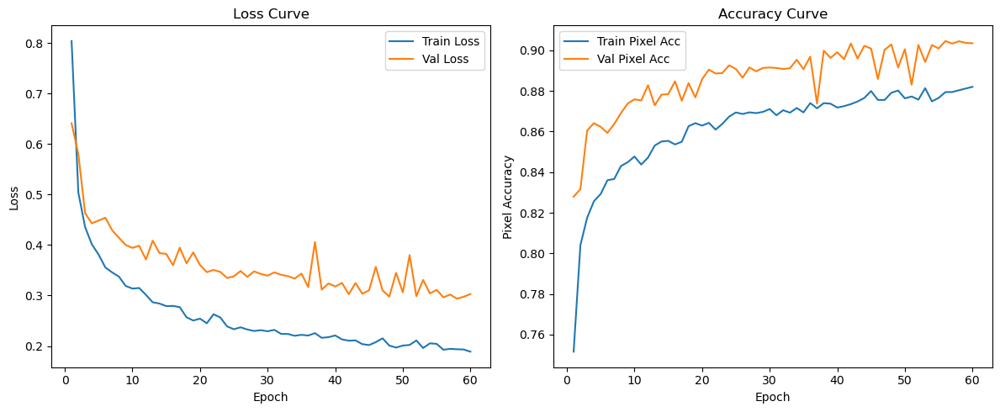

In [9]:
device = torch.device("cuda:2" if torch.cuda.is_available() else "cpu")

model = DeepLabV3Plus(num_classes=19)  
criterion = nn.CrossEntropyLoss(ignore_index=255)
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=1e-5)

train_model(model, train_loader, val_loader, num_epochs=60,
            criterion=criterion, optimizer=optimizer, device=device, save_path='/data/semantic-segmentation-models/attention-model.pth')

In [10]:
avg_loss,pixel_acc,mIoU=evaluate(model,val_loader,criterion, device)

print("Average Loss ",avg_loss)
print("Pixel Accu",pixel_acc)
print("mIoU:", mIoU)

Validating: 100%|███████████████████████████████████████████████████████████████████████████████████████████████| 32/32 [00:16<00:00,  2.00it/s]

Average Loss  0.3030213541351259
Pixel Accu 0.9034228448616504
mIoU: 0.5067152488748138


In [11]:
import matplotlib.pyplot as plt
import torchvision.transforms.functional as TF
from matplotlib.colors import ListedColormap

# Simple colormap for 19 classes (you can customize it)
def get_colormap():
    base_colors = plt.cm.tab20b(np.linspace(0, 1, 20))
    return ListedColormap(base_colors[:19])

def visualize_predictions(model, dataloader, device, num_samples=5):
    cmap = get_colormap()
    model.eval()

    with torch.no_grad():
        for i, (images, labels) in enumerate(dataloader):
            if i >= num_samples:
                break

            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            preds = outputs.argmax(dim=1)

            for j in range(images.size(0)):
                img = images[j].cpu().permute(1, 2, 0).numpy()
                img = (img * [0.229, 0.224, 0.225]) + [0.485, 0.456, 0.406]  # unnormalize
                img = np.clip(img, 0, 1)

                label = labels[j].cpu().numpy()
                pred = preds[j].cpu().numpy()

                fig, axs = plt.subplots(1, 3, figsize=(18, 6))
                axs[0].imshow(img)
                axs[0].set_title("Input Image")
                axs[0].axis("off")

                axs[1].imshow(label, cmap=cmap, vmin=0, vmax=18)
                axs[1].set_title("Ground Truth")
                axs[1].axis("off")

                axs[2].imshow(pred, cmap=cmap, vmin=0, vmax=18)
                axs[2].set_title("Predicted Mask")
                axs[2].axis("off")

                plt.tight_layout()
                plt.show()

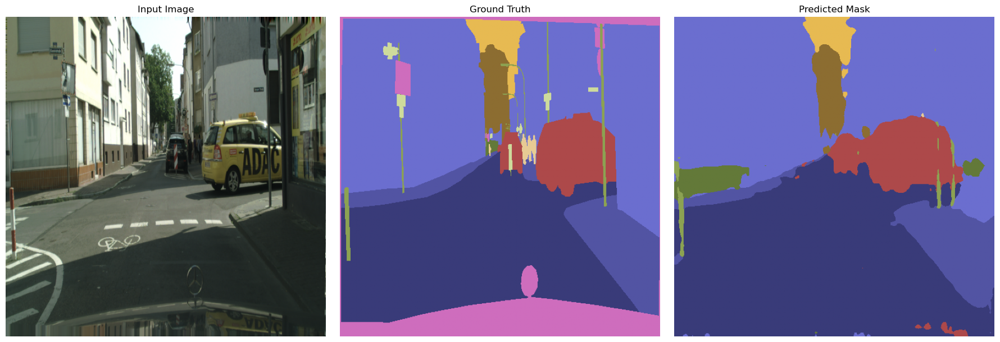

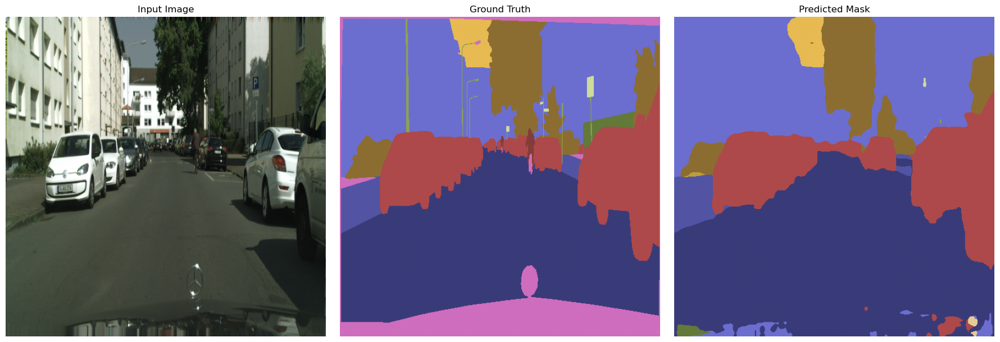

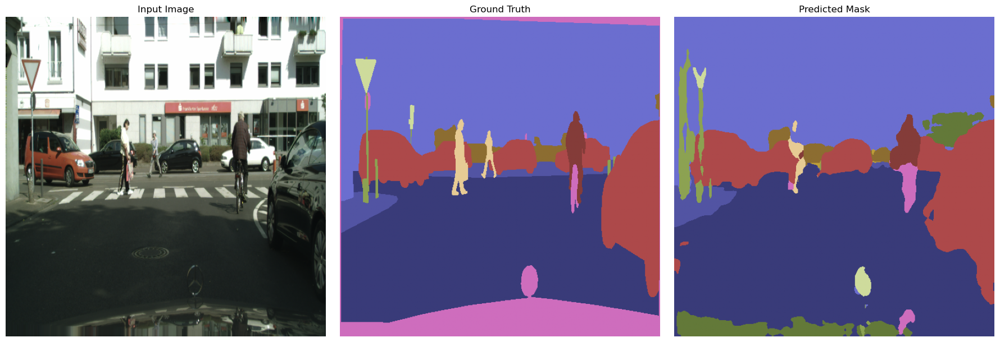

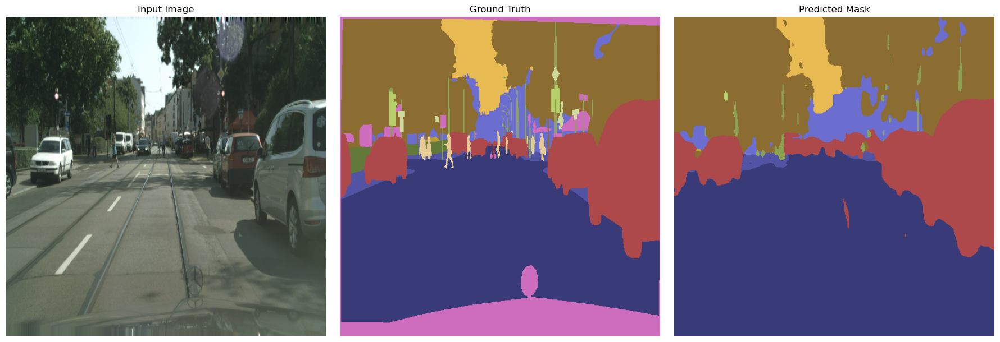

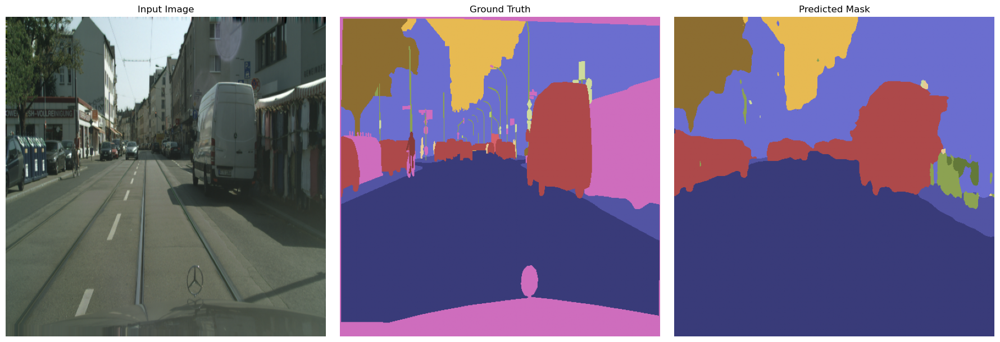

...

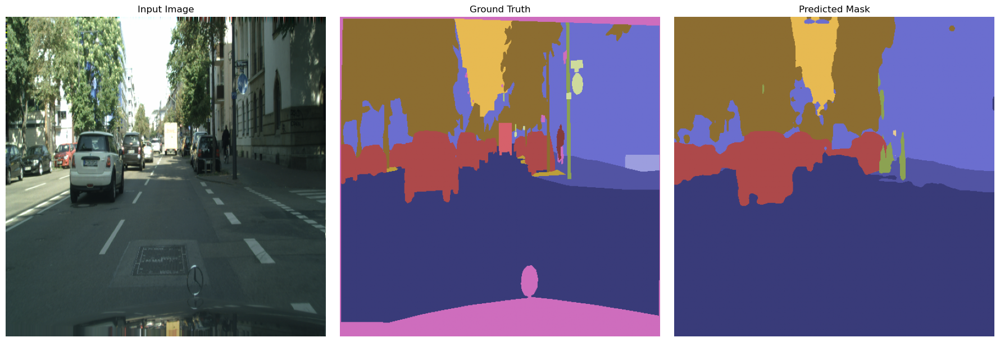

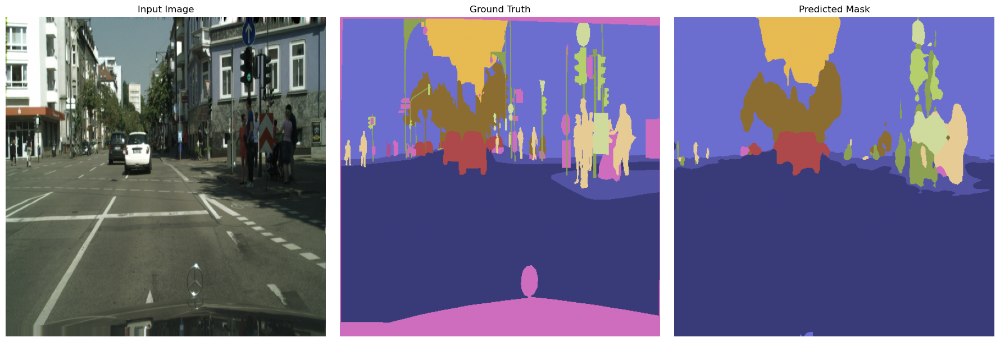

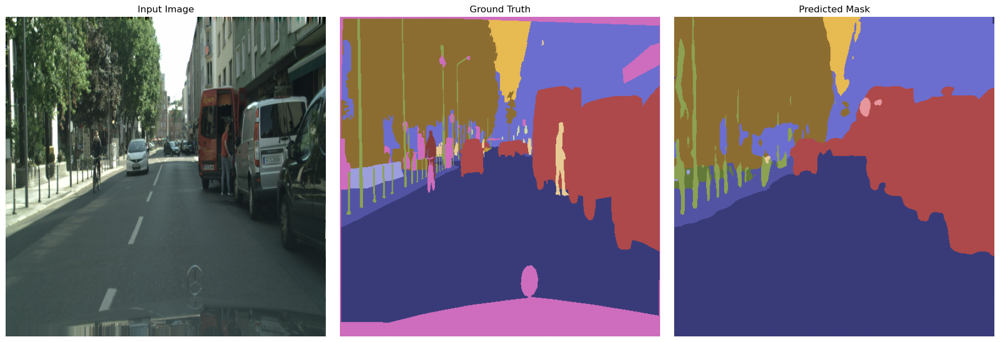

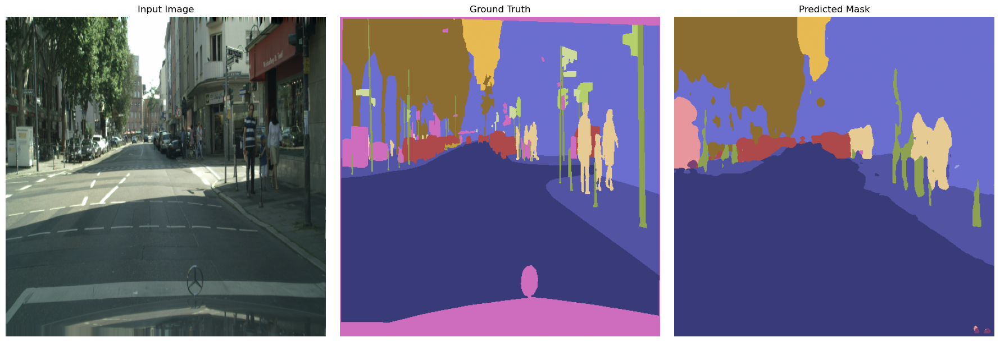

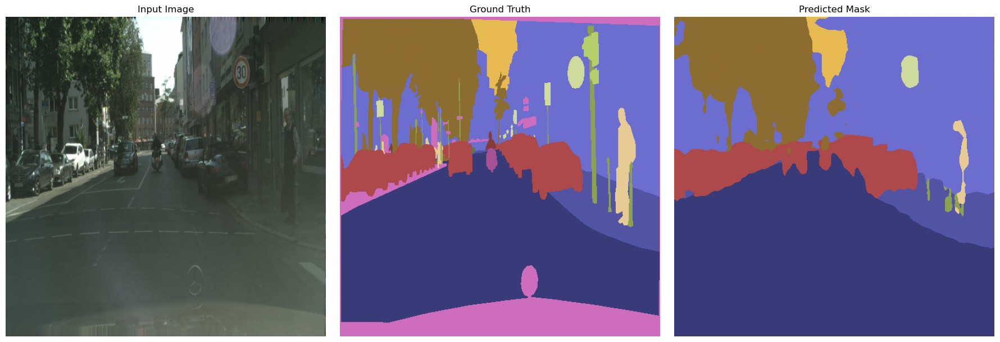

In [ ]:
visualize_predictions(model, val_loader, device, num_samples=3)